Experiment 1

VGG16 OpenCV data augmentation

In [81]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam,SGD
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping

import scipy.io
import numpy as np
import os
from PIL import Image
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [82]:
# Do we have access to a GPU? Sanity Check
device_list = tf.config.list_physical_devices()
if "GPU" in [device.device_type for device in device_list]:
  print(f"[INFO] TensorFlow has GPU available to use. Woohoo!! Computing will be sped up!")
  print(f"[INFO] Accessible devices:\n{device_list}")
else:
  print(f"[INFO] TensorFlow does not have GPU available to use. Models may take a while to train.")
  print(f"[INFO] Accessible devices:\n{device_list}")

[INFO] TensorFlow has GPU available to use. Woohoo!! Computing will be sped up!
[INFO] Accessible devices:
[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [83]:
import os
path = '/kaggle/input/big-cats-images-dataset/'
len(os.listdir(path))

9

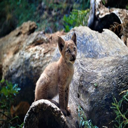

In [84]:
from PIL import Image

im =Image.open('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image100.jpg').resize((128,128))
im

In [85]:
cat_labels = set()

    
for d in os.listdir(path):
    cat_labels.add(d)

In [86]:
len(cat_labels)
num_classes = len(cat_labels)
batch_size = 64

In [87]:
cats_labels = list(cat_labels)
cats_labels_path = [path + s for s in cats_labels]

In [88]:
import cv2
def load_and_preprocess_image(path):
    image = cv2.imread(path)
    image = cv2.resize(image, (224,224))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

In [89]:
X = []
y = []

for type_path, label in zip(cats_labels_path,cats_labels) :
    for image_path in os.listdir(type_path):
        image = load_and_preprocess_image(type_path+"/"+image_path)
        
        X.append(image)
        y.append(label)

865


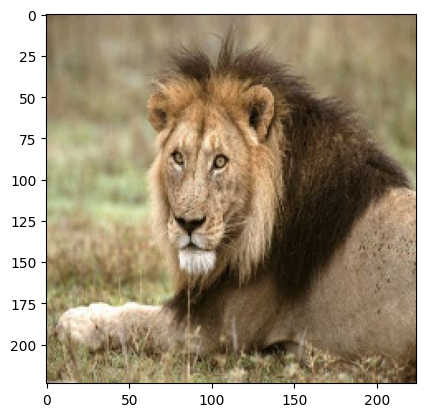

In [90]:
import matplotlib.pyplot as plt
print(len(X))
plt.imshow(X[100])

In [91]:
from sklearn.preprocessing import LabelBinarizer
import numpy as np
encoder = LabelBinarizer()

X = np.array(X)
y = encoder.fit_transform(np.array(y))

In [92]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=42, shuffle=True)

In [93]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D
from tensorflow.keras.models import Model, Sequential
base_model=VGG16(weights='imagenet',include_top=False)

x=base_model.output
x=GlobalAveragePooling2D()(x)
x=Dense(1024,activation='relu')(x)
x=Dropout(0.5)(x)
x=Dense(512,activation='relu')(x)
x=Dropout(0.2)(x)
x=Dense(256,activation='relu')(x)
preds=Dense(num_classes,activation='softmax')(x)

model=Model(inputs=base_model.input,outputs=preds)

for layer in model.layers[:-5]:
    layer.trainable=False
for layer in model.layers[-5:]:
    layer.trainable=True
    
model.compile("adam",loss="categorical_crossentropy",metrics=["accuracy"])

print(model.summary())

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_5 (InputLayer)           │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, None, None, 64)      │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, None, None, 64)      │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, None, None, 64)      │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, None, None, 128)     │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, None, None, 128)     │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, None, None, 128)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, None, None, 256)     │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, None, None, 256)     │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, None, None, 256)     │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, None, None, 256)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, None, None, 512)     │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, None, None, 512)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, None, None, 512)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_4           │ (None, 512)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_15 (Dense)                     │ (None, 1024)                │         525,3

 Total params: 15,898,441 (60.65 MB)

 Trainable params: 658,441 (2.51 MB)

 Non-trainable params: 15,240,000 (58.14 MB)

None


In [94]:
from tensorflow.keras.callbacks import ReduceLROnPlateau
checkpoint = ModelCheckpoint(
    './base.model.keras',
    monitor='val_loss',
    verbose=1,
    save_best_only=True,
    mode='min',
    save_weights_only=False,
)
earlystop = EarlyStopping(patience=10, verbose=1,restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(factor=0.1, patience=10,verbose=1)

In [95]:
history = model.fit(X_train,y_train,batch_size=batch_size,epochs=50,validation_data=(X_test,y_test), callbacks=[checkpoint,earlystop, reduce_lr])

Epoch 1/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step - accuracy: 0.1794 - loss: 8.8351
Epoch 1: val_loss improved from inf to 2.32905, saving model to ./base.model.keras
11/11 ━━━━━━━━━━━━━━━━━━━━ 7s 423ms/step - accuracy: 0.1872 - loss: 8.6343 - val_accuracy: 0.4682 - val_loss: 2.3291 - learning_rate: 0.0010
Epoch 2/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - accuracy: 0.5187 - loss: 2.0456
Epoch 2: val_loss improved from 2.32905 to 1.02387, saving model to ./base.model.keras
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 190ms/step - accuracy: 0.5233 - loss: 2.0112 - val_accuracy: 0.6243 - val_loss: 1.0239 - learning_rate: 0.0010
Epoch 3/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step - accuracy: 0.6449 - loss: 1.1035
Epoch 3: val_loss improved from 1.02387 to 0.53299, saving model to ./base.model.keras
11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 183ms/step - accuracy: 0.6459 - loss: 1.0994 - val_accuracy: 0.8208 - val_loss: 0.5330 - learning_rate: 0.0010
Epoch 4/50
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step - accuracy

In [96]:
loss, acc = model.evaluate(X_test,y_test,verbose=0)
print(f"loss on the test set is {loss:.2f}")
print(f"accuracy on the test set is {acc:.3f}")

loss on the test set is 0.32
accuracy on the test set is 0.919


In [97]:
predictions = model.predict(X_test)

6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 119ms/step


In [98]:
label_predictions = encoder.inverse_transform(predictions)

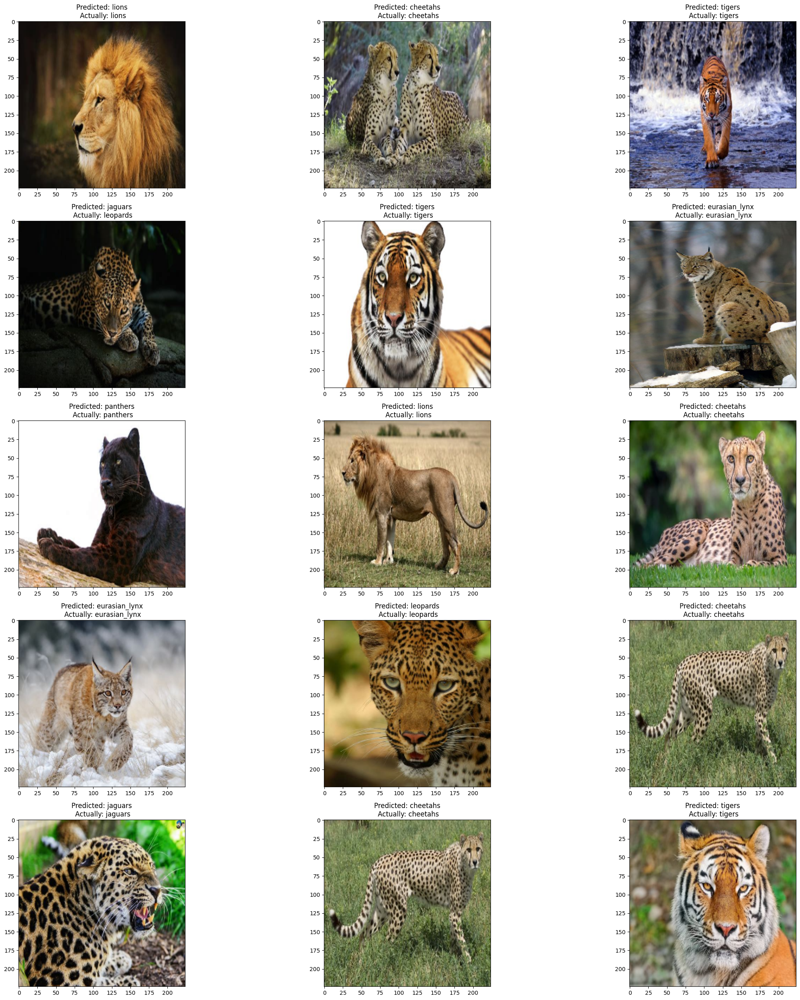

In [99]:
rows, cols = 5, 3
size = 25

fig,ax=plt.subplots(rows,cols)
fig.set_size_inches(size,size)
for i in range(rows):
    for j in range (cols):
        index = np.random.randint(0,len(X_test))
        ax[i,j].imshow(X_test[index])
        ax[i,j].set_title(f'Predicted: {label_predictions[index]}\n Actually: {encoder.inverse_transform(y_test)[index]}')
        
plt.tight_layout()

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - accuracy: 0.8941 - loss: 0.3702


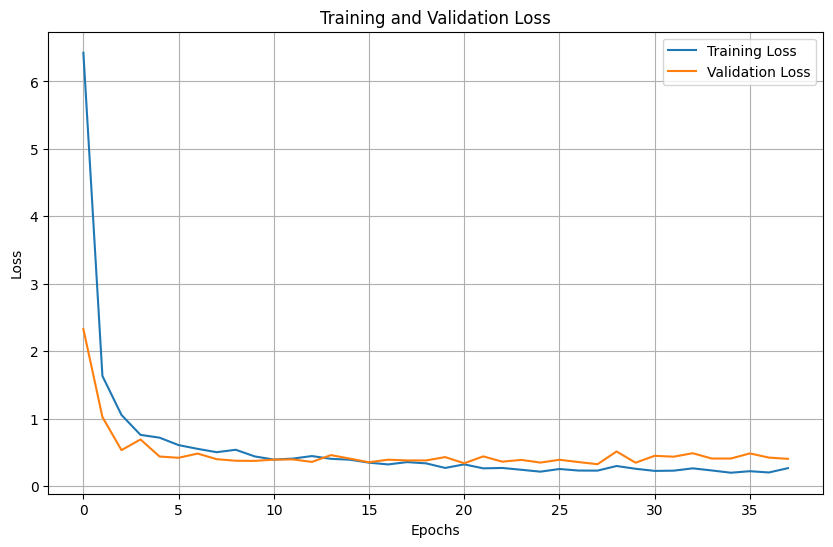

In [100]:
import matplotlib.pyplot as plt
model.evaluate(X_test, y_test)
# Extract loss values from the history object
history_dict = history.history
loss = history_dict['loss']
val_loss = history_dict['val_loss']

# Plot the loss curves
plt.figure(figsize=(10, 6))
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


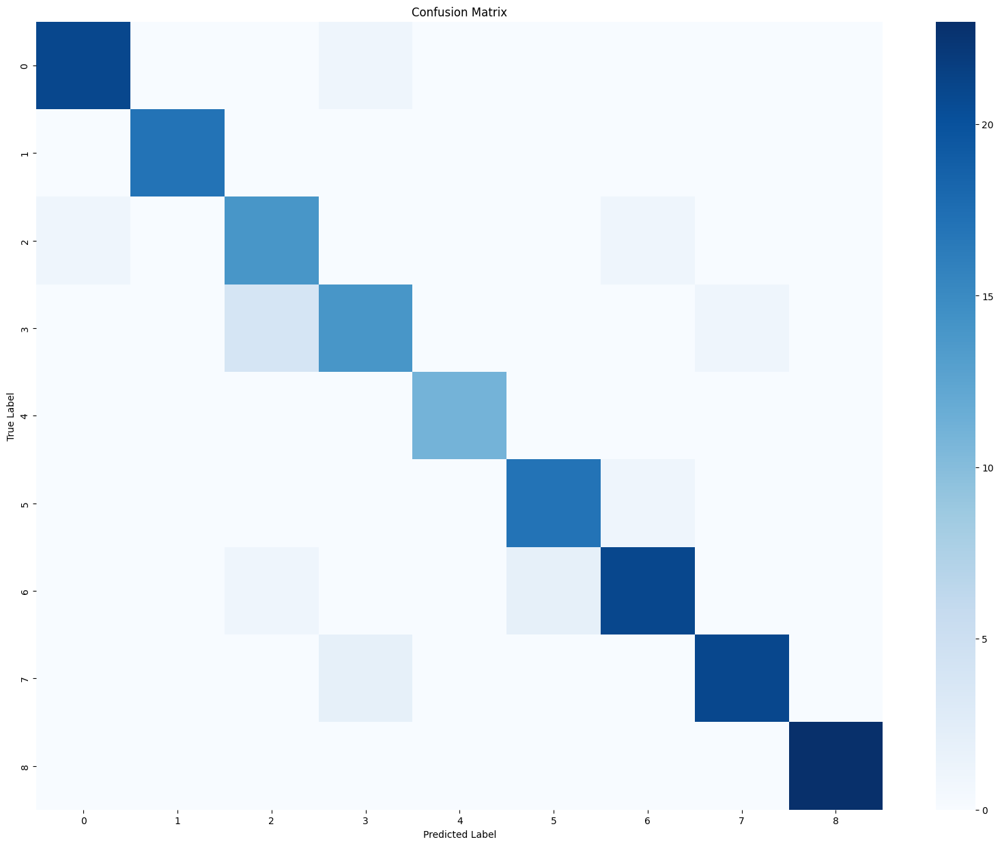

In [101]:
# Create a confusion matrix
# Assuming model predictions and true labels are available
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)  # Convert predictions to class labels
y_true = np.argmax(y_test, axis=1)  # Convert one-hot encoded labels to class labels

conf_matrix = confusion_matrix(y_true, y_pred_classes)
fig, ax = plt.subplots(figsize=(20, 15))  # Adjust figsize for better visibility with 120 classes
sns.heatmap(conf_matrix, annot=False, cmap='Blues', ax=ax)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [102]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, roc_curve, auc
from sklearn.preprocessing import label_binarize
# Print classification report for precision, recall, and F1-score
print("Classification Report:")
print(classification_report(y_true, y_pred_classes))

Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.95      0.95        22
           1       1.00      1.00      1.00        17
           2       0.74      0.88      0.80        16
           3       0.82      0.74      0.78        19
           4       1.00      1.00      1.00        11
           5       0.89      0.94      0.92        18
           6       0.91      0.88      0.89        24
           7       0.95      0.91      0.93        23
           8       1.00      1.00      1.00        23

    accuracy                           0.92       173
   macro avg       0.92      0.92      0.92       173
weighted avg       0.92      0.92      0.92       173



In [103]:
# Plot ROC AUC curve
n_classes = y_test.shape[1]  # Number of classes
y_test_binarized = label_binarize(y_true, classes=np.arange(n_classes))

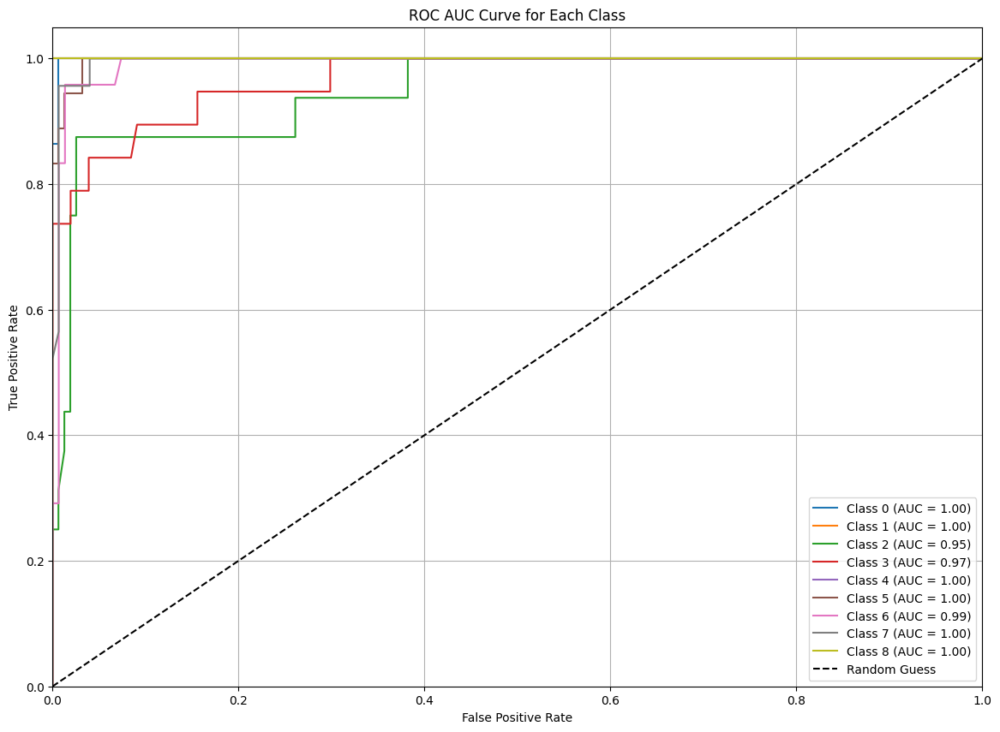

In [104]:
# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_binarized[:, i], y_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot the ROC AUC curve for each class
plt.figure(figsize=(14, 10))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.title('ROC AUC Curve for Each Class')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

**Experiment 2**

***VGG16 - Image Data Augmentator*** 

In [105]:
#batch_size=32##This parameter should Be set according to your GPU/CPU capacity . Else Be Ready FOr Exhaust Error!
#num_classes = 120
image_size = 224
num_channels = 3

In [106]:
!pip install split-folders

In [107]:
import splitfolders
splitfolders.ratio(path, output="output",seed=1337, ratio=(.7, .2,.1), group_prefix=None, move=False) # default values

Copying files: 865 files [00:02, 417.96 files/s]


In [108]:
#VGG16
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.vgg16 import preprocess_input
train_dir = '/kaggle/working/output/train'
test_dir = '/kaggle/working/output/test'
val_dir = '/kaggle/working/output/val'
train_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
    )

# Validation/Test data generator without augmentation
valid_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
test_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create validation generator
validation_generator = train_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create test generator
test_generator = valid_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

Found 602 images belonging to 9 classes.
Found 171 images belonging to 9 classes.
Found 92 images belonging to 9 classes.


In [109]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D,BatchNormalization
from tensorflow.keras.models import Model, Sequential
base_model=VGG16(weights='imagenet',include_top=False, input_shape=(224,224,3))
x = base_model.output
x = Flatten()(x)
x = Dropout(0.4)(x)
# let's add two fully-connected layer
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
# and a softmax layer -- let's say we have 200 classes
predictions = Dense(num_classes, activation='softmax')(x)

# this is the model we will train
model = Model(inputs=base_model.input, outputs=predictions)

# first: train only the top layers (which were randomly initialized)
# i.e. freeze all convolutional InceptionV3 layers
for layer in base_model.layers:
    layer.trainable = False

# compile the model (should be done *after* setting layers to non-trainable)
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

print(model.summary())

Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_11 (Dropout)                 │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 70,328,137 (268.28 MB)

 Trainable params: 55,605,257 (212.12 MB)

 Non-trainable params: 14,722,880 (56.16 MB)

None


In [110]:
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping, ReduceLROnPlateau
#from tensorflow.keras.optimizers import Adam,SGD
checkpoint = ModelCheckpoint(
    './base.model.keras',
    monitor='val_loss',
    verbose=2,
    save_best_only=True,
    mode='min',
    save_weights_only=False,
)
earlystop = EarlyStopping(
    monitor='val_loss',
    min_delta=0.00001,
    patience=5,
    verbose=1,
    mode='auto'
)
reduce = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.1,
    patience=3,
    verbose=1,
    mode='auto'
)

In [111]:
history = model.fit(
        train_generator,
        epochs=25,
        validation_data=validation_generator,
        callbacks=[checkpoint, earlystop]
    )

Epoch 1/25


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step - accuracy: 0.2169 - loss: 2.5567
Epoch 1: val_loss improved from inf to 1.74841, saving model to ./base.model.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 28s 2s/step - accuracy: 0.2310 - loss: 2.5020 - val_accuracy: 0.5906 - val_loss: 1.7484
Epoch 2/25
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step - accuracy: 0.6772 - loss: 0.9856
Epoch 2: val_loss improved from 1.74841 to 0.81342, saving model to ./base.model.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 13s 866ms/step - accuracy: 0.6789 - loss: 0.9788 - val_accuracy: 0.7602 - val_loss: 0.8134
Epoch 3/25
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step - accuracy: 0.8050 - loss: 0.5776
Epoch 3: val_loss improved from 0.81342 to 0.57895, saving model to ./base.model.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 13s 887ms/step - accuracy: 0.8054 - loss: 0.5748 - val_accuracy: 0.8480 - val_loss: 0.5789
Epoch 4/25
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step - accuracy: 0.8235 - loss: 0.5263
Epoch 4: val_loss improved from 0.57895 to 0.48161, saving 

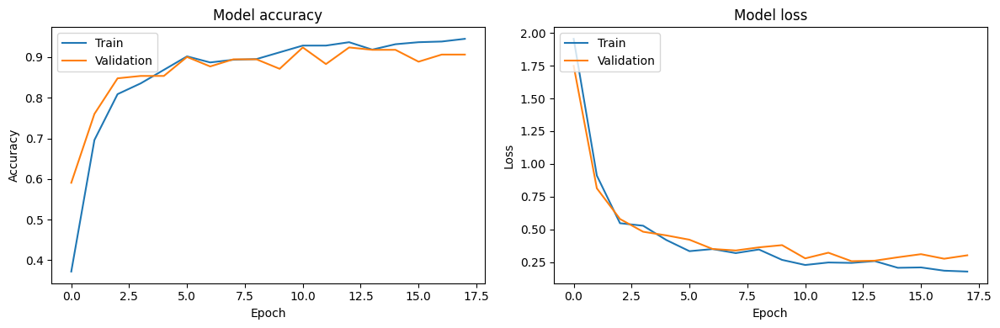

In [112]:
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 389ms/step - accuracy: 0.8755 - loss: 0.9499
Test Accuracy: 89.13%
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 397ms/step


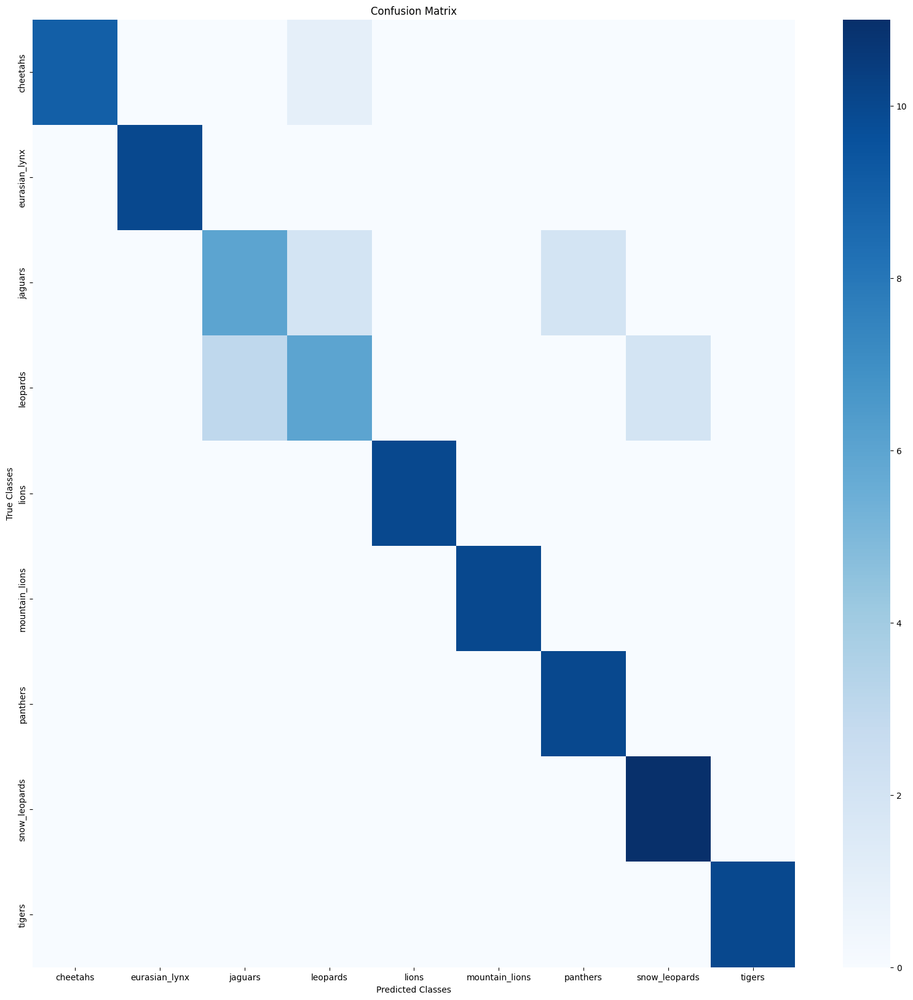

                precision    recall  f1-score   support

      cheetahs       1.00      0.90      0.95        10
 eurasian_lynx       1.00      1.00      1.00        10
       jaguars       0.67      0.60      0.63        10
      leopards       0.67      0.55      0.60        11
         lions       1.00      1.00      1.00        10
mountain_lions       1.00      1.00      1.00        10
      panthers       0.83      1.00      0.91        10
 snow_leopards       0.85      1.00      0.92        11
        tigers       1.00      1.00      1.00        10

      accuracy                           0.89        92
     macro avg       0.89      0.89      0.89        92
  weighted avg       0.89      0.89      0.89        92



In [113]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


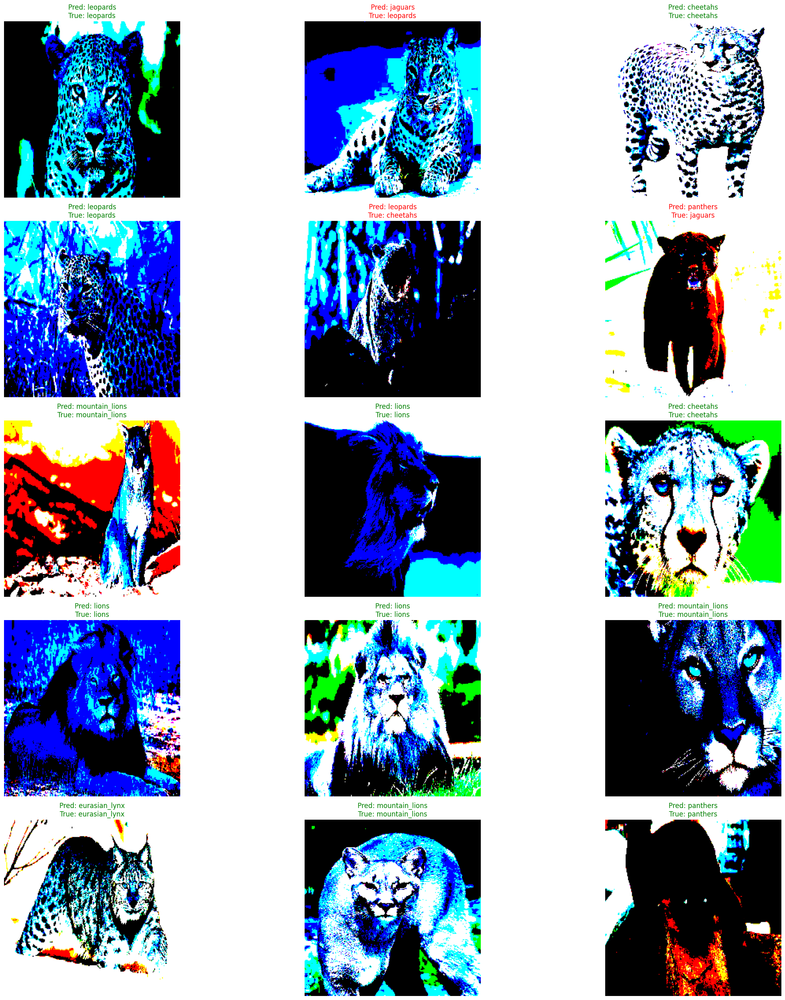

In [114]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]

        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization

        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


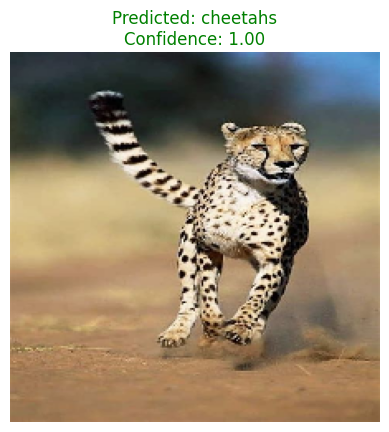

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


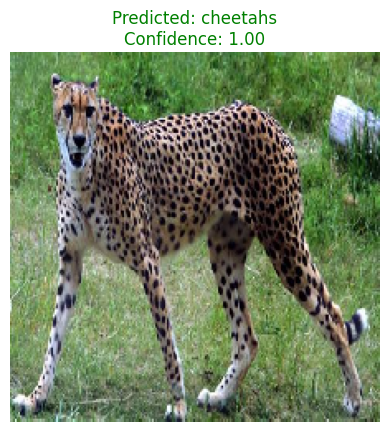

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


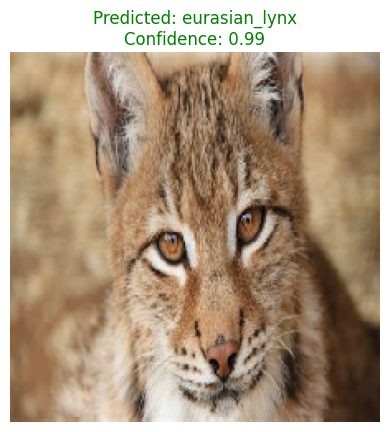

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


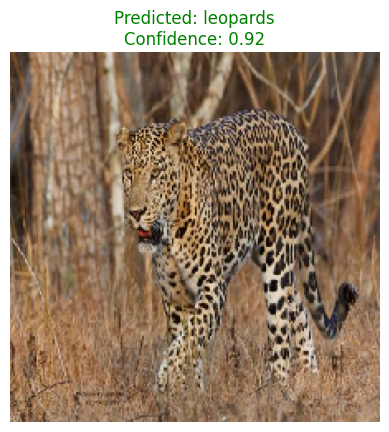

In [115]:
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

def test_single_image(img_path, model, class_names):
    """
    Tests a single image using the trained model and displays the predicted label.

    Args:
        img_path (str): Path to the image file.
        model (keras.Model): Trained model.
        class_names (list): List of class names.
    """
    # Load and preprocess the image
    img = image.load_img(img_path, target_size=(224, 224))  # Resize to model's input size
    img_array = image.img_to_array(img)  # Convert to numpy array
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array = preprocess_input(img_array)  # Preprocess using the same function as training

    # Make prediction
    prediction = model.predict(img_array)
    predicted_class = class_names[np.argmax(prediction)]  # Get the predicted class name
    confidence = np.max(prediction)  # Confidence score

    # Display the image and prediction
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Predicted: {predicted_class}\nConfidence: {confidence:.2f}", color='green')
    plt.show()

# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

***Resnet50***

In [116]:
#ResNet50
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import preprocess_input
train_dir = '/kaggle/working/output/train'
test_dir = '/kaggle/working/output/test'
val_dir = '/kaggle/working/output/val'
train_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
    )

# Validation/Test data generator without augmentation
valid_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
test_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create validation generator
validation_generator = train_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create test generator
test_generator = valid_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

Found 602 images belonging to 9 classes.
Found 171 images belonging to 9 classes.
Found 92 images belonging to 9 classes.


In [117]:
from tensorflow.keras.applications import ResNet50
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    
    # Freeze the base model layers
for layer in base_model.layers[:-30]:  # Keep some layers trainable for fine-tuning
    layer.trainable = False
    
    # Add custom layers for classification
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(num_classes, activation='softmax')(x)
    
model = Model(inputs=base_model.input, outputs=predictions)

In [118]:
model.compile(
        optimizer=Adam(learning_rate=0.001),
        loss='categorical_crossentropy',
        metrics=['accuracy']
)
print(model.summary())

Model: "functional_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_7             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer_7[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 24,641,417 (94.00 MB)

 Trainable params: 15,503,881 (59.14 MB)

 Non-trainable params: 9,137,536 (34.86 MB)

None


In [119]:
callbacks = [
        ModelCheckpoint(
            'best_model.h5.keras',
            monitor='val_loss',
            save_best_only=True,
            mode='min',
            verbose=1
        ),
        ReduceLROnPlateau(
            monitor='val_loss',
            factor=0.2,
            patience=5,
            min_lr=1e-6,
            verbose=1
        ),
        EarlyStopping(
            monitor='val_loss',
            patience=10,
            restore_best_weights=True,
            verbose=1
        )
    ]

In [120]:
history = model.fit(
        train_generator,
        epochs=50,
        validation_data=validation_generator,
        callbacks=callbacks
    )

Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 639ms/step - accuracy: 0.4170 - loss: 1.8696
Epoch 1: val_loss improved from inf to 22.73807, saving model to best_model.h5.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.4336 - loss: 1.8173 - val_accuracy: 0.6316 - val_loss: 22.7381 - learning_rate: 0.0010
Epoch 2/50
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - accuracy: 0.8733 - loss: 0.4497
Epoch 2: val_loss did not improve from 22.73807
10/10 ━━━━━━━━━━━━━━━━━━━━ 9s 448ms/step - accuracy: 0.8738 - loss: 0.4524 - val_accuracy: 0.4386 - val_loss: 56.8346 - learning_rate: 0.0010
Epoch 3/50
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step - accuracy: 0.9231 - loss: 0.2166
Epoch 3: val_loss did not improve from 22.73807
10/10 ━━━━━━━━━━━━━━━━━━━━ 9s 395ms/step - accuracy: 0.9228 - loss: 0.2177 - val_accuracy: 0.4971 - val_loss: 28.0891 - learning_rate: 0.0010
Epoch 4/50
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step - accuracy: 0.9507 - loss: 0.2062
Epoch 4: val_loss did not improve from 22.73807
10/10 ━━━━━━━━

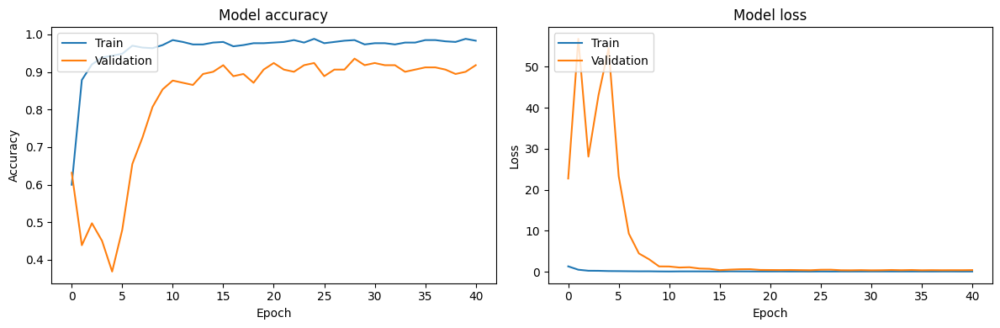

In [121]:
plt.figure(figsize=(12, 4))
    
# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
plt.tight_layout()
plt.show()

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 1s/step - accuracy: 0.8630 - loss: 1.2486  
Test Accuracy: 88.04%
2/2 ━━━━━━━━━━━━━━━━━━━━ 6s 3s/step


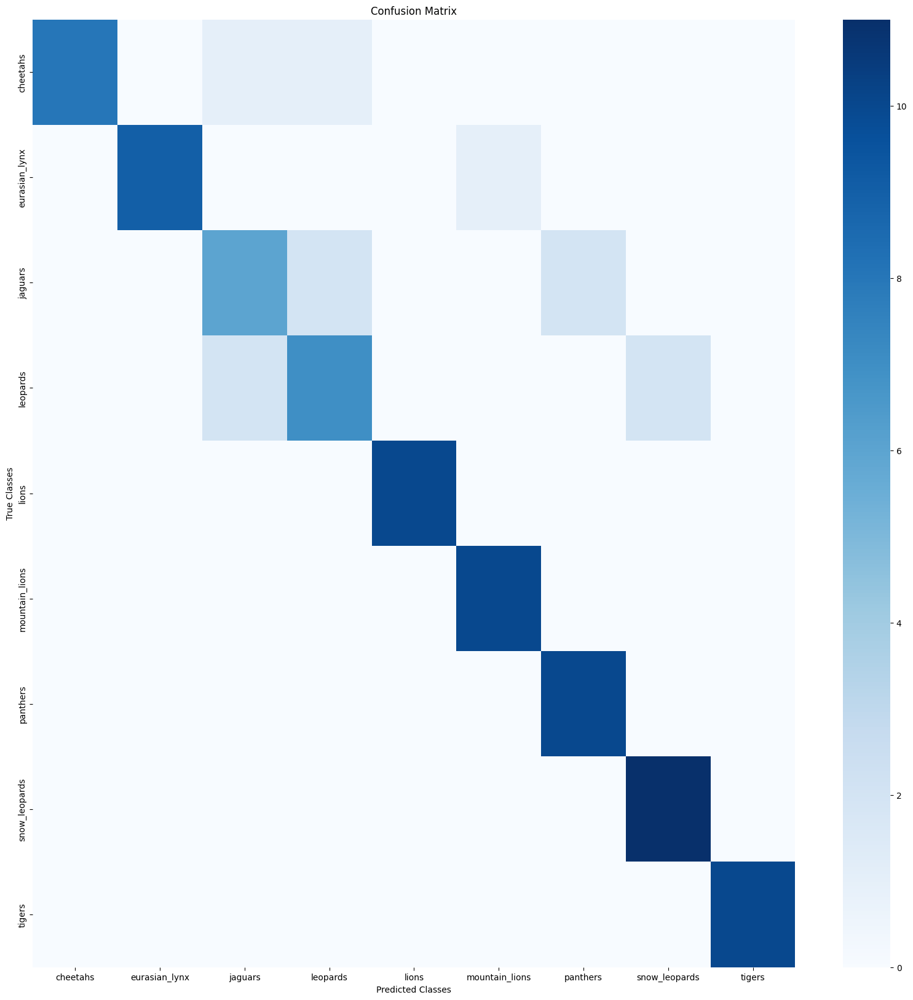

                precision    recall  f1-score   support

      cheetahs       1.00      0.80      0.89        10
 eurasian_lynx       1.00      0.90      0.95        10
       jaguars       0.67      0.60      0.63        10
      leopards       0.70      0.64      0.67        11
         lions       1.00      1.00      1.00        10
mountain_lions       0.91      1.00      0.95        10
      panthers       0.83      1.00      0.91        10
 snow_leopards       0.85      1.00      0.92        11
        tigers       1.00      1.00      1.00        10

      accuracy                           0.88        92
     macro avg       0.88      0.88      0.88        92
  weighted avg       0.88      0.88      0.88        92



In [122]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step


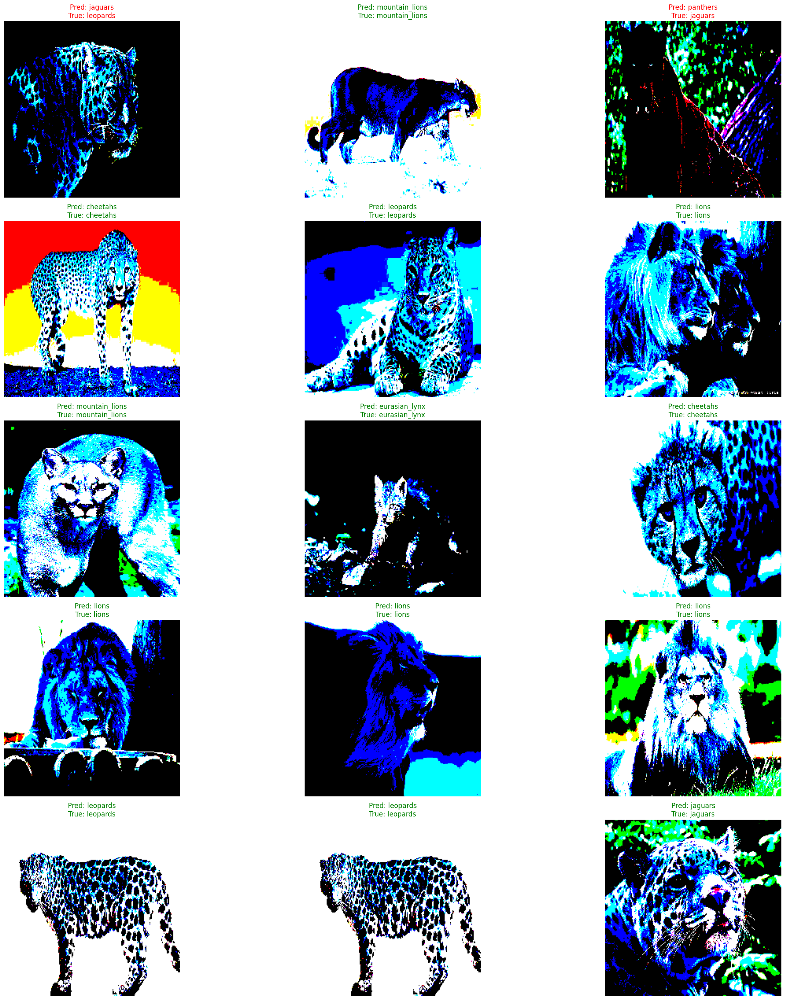

In [123]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]
        
        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization
        
        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


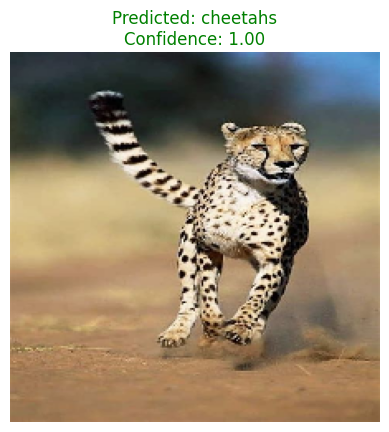

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


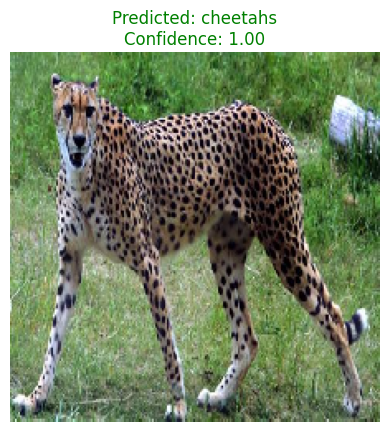

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


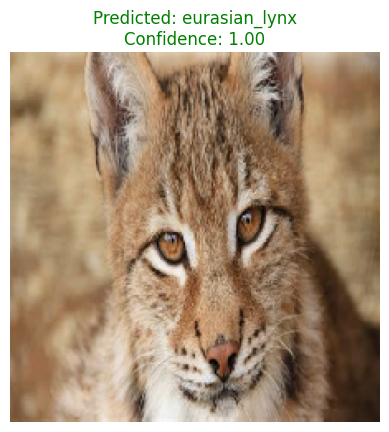

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


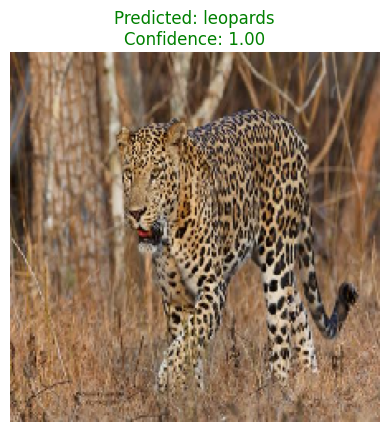

In [124]:
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt

def test_single_image(img_path, model, class_names):
    """
    Tests a single image using the trained model and displays the predicted label.

    Args:
        img_path (str): Path to the image file.
        model (keras.Model): Trained model.
        class_names (list): List of class names.
    """
    # Load and preprocess the image
    img = image.load_img(img_path, target_size=(224, 224))  # Resize to model's input size
    img_array = image.img_to_array(img)  # Convert to numpy array
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array = preprocess_input(img_array)  # Preprocess using the same function as training

    # Make prediction
    prediction = model.predict(img_array)
    predicted_class = class_names[np.argmax(prediction)]  # Get the predicted class name
    confidence = np.max(prediction)  # Confidence score

    # Display the image and prediction
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Predicted: {predicted_class}\nConfidence: {confidence:.2f}", color='green')
    plt.show()

# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

***Experiment 3: ResNet SGD***

In [125]:
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    
    # Freeze the base model layers
for layer in base_model.layers[:-30]:  # Keep some layers trainable for fine-tuning
    layer.trainable = False
    
    # Add custom layers for classification
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(num_classes, activation='softmax')(x)
    
model = Model(inputs=base_model.input, outputs=predictions)

In [126]:
model.compile(
        optimizer=SGD(learning_rate=0.001),
        loss='categorical_crossentropy',
        metrics=['accuracy']
)
print(model.summary())

Model: "functional_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer_8[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 24,641,417 (94.00 MB)

 Trainable params: 15,503,881 (59.14 MB)

 Non-trainable params: 9,137,536 (34.86 MB)

None


In [127]:
callbacks = [
        ModelCheckpoint(
            'best_model.h5.keras',
            monitor='val_loss',
            save_best_only=True,
            mode='min',
            verbose=1
        ),
        ReduceLROnPlateau(
            monitor='val_loss',
            factor=0.2,
            patience=5,
            min_lr=1e-6,
            verbose=1
        ),
        EarlyStopping(
            monitor='val_loss',
            patience=10,
            restore_best_weights=True,
            verbose=1
        )
    ]

In [128]:
history = model.fit(
        train_generator,
        epochs=50,
        validation_data=validation_generator,
        callbacks=callbacks
    )

Epoch 1/50
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 644ms/step - accuracy: 0.1307 - loss: 2.6925
Epoch 1: val_loss improved from inf to 2.06346, saving model to best_model.h5.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 30s 2s/step - accuracy: 0.1311 - loss: 2.6884 - val_accuracy: 0.2281 - val_loss: 2.0635 - learning_rate: 0.0010
Epoch 2/50
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step - accuracy: 0.1634 - loss: 2.4073
Epoch 2: val_loss improved from 2.06346 to 1.93528, saving model to best_model.h5.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 10s 533ms/step - accuracy: 0.1642 - loss: 2.4040 - val_accuracy: 0.2865 - val_loss: 1.9353 - learning_rate: 0.0010
Epoch 3/50
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step - accuracy: 0.1937 - loss: 2.2977
Epoch 3: val_loss improved from 1.93528 to 1.77590, saving model to best_model.h5.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 10s 488ms/step - accuracy: 0.1958 - loss: 2.2899 - val_accuracy: 0.3450 - val_loss: 1.7759 - learning_rate: 0.0010
Epoch 4/50
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step - accur

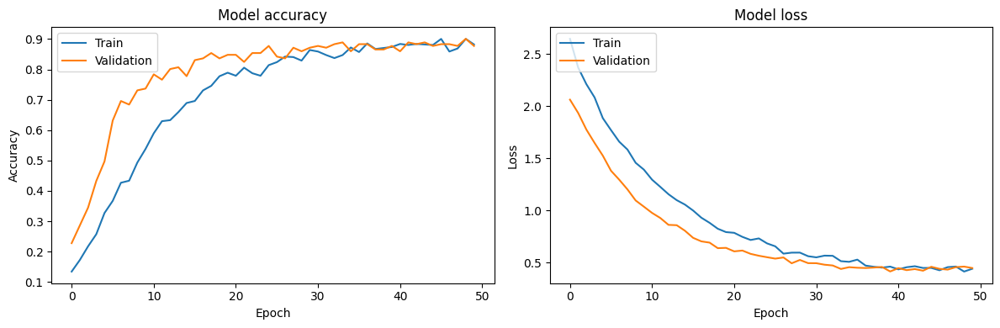

In [129]:
plt.figure(figsize=(12, 4))
    
# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
    
plt.tight_layout()
plt.show()

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - accuracy: 0.8755 - loss: 0.5028  
Test Accuracy: 89.13%
2/2 ━━━━━━━━━━━━━━━━━━━━ 6s 3s/step


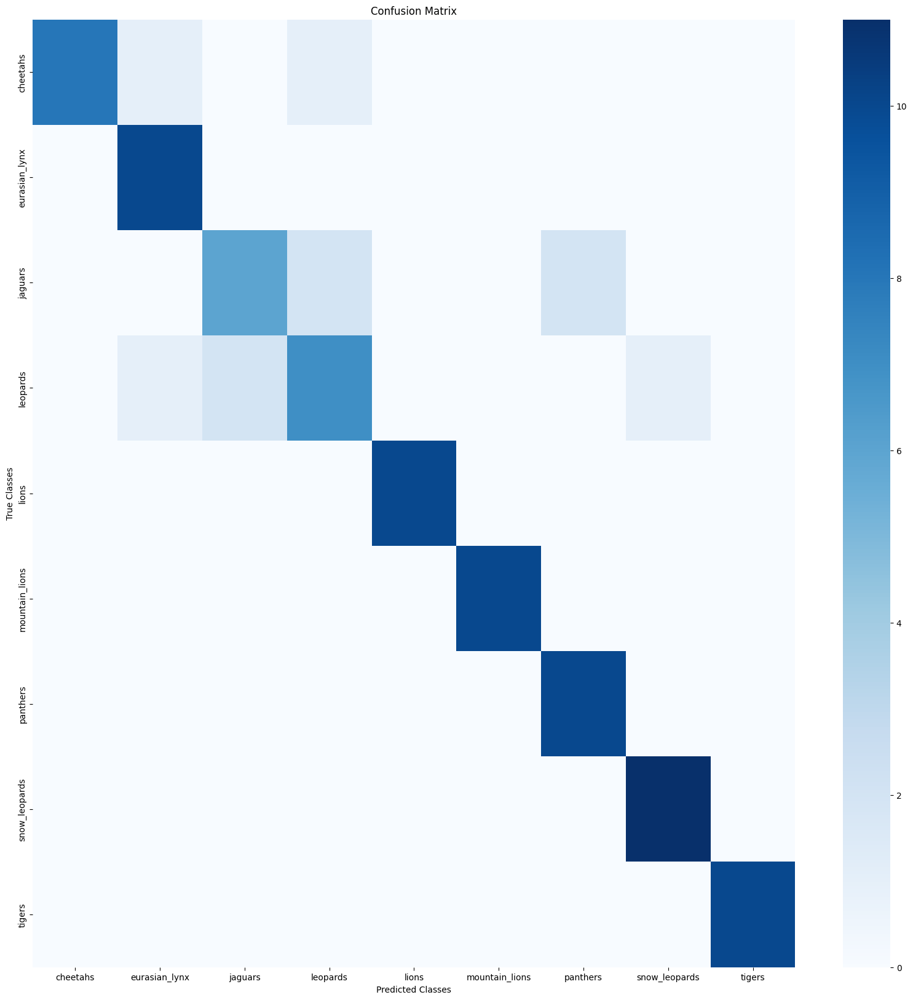

                precision    recall  f1-score   support

      cheetahs       1.00      0.80      0.89        10
 eurasian_lynx       0.83      1.00      0.91        10
       jaguars       0.75      0.60      0.67        10
      leopards       0.70      0.64      0.67        11
         lions       1.00      1.00      1.00        10
mountain_lions       1.00      1.00      1.00        10
      panthers       0.83      1.00      0.91        10
 snow_leopards       0.92      1.00      0.96        11
        tigers       1.00      1.00      1.00        10

      accuracy                           0.89        92
     macro avg       0.89      0.89      0.89        92
  weighted avg       0.89      0.89      0.89        92



In [130]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


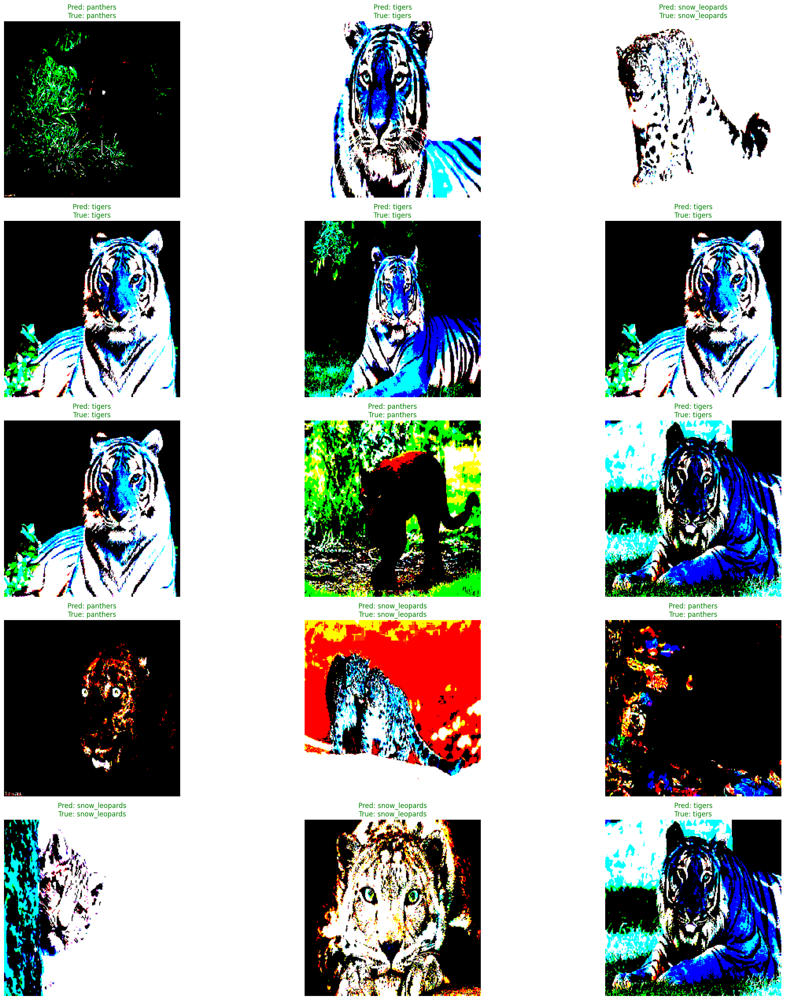

In [131]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]
        
        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization
        
        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


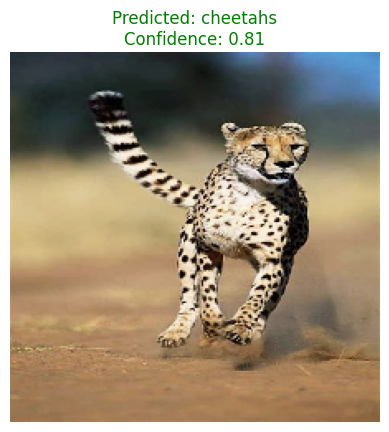

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


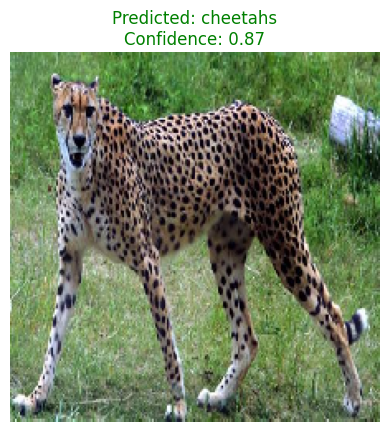

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


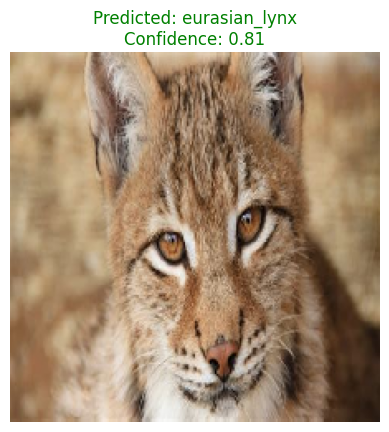

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


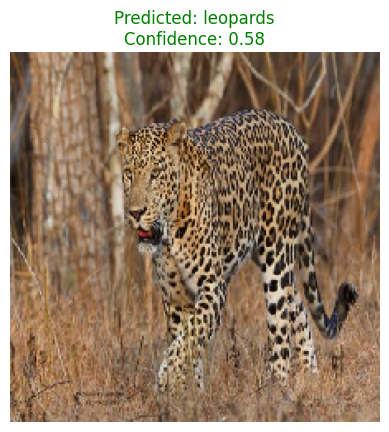

In [132]:
# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

**Experiment 4: VGG16**

In [133]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.vgg16 import preprocess_input
train_dir = '/kaggle/working/output/train'
test_dir = '/kaggle/working/output/test'
val_dir = '/kaggle/working/output/val'
train_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
    )

# Validation/Test data generator without augmentation
valid_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
test_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_input
    )
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create validation generator
validation_generator = train_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
)

# Create test generator
test_generator = valid_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

Found 602 images belonging to 9 classes.
Found 171 images belonging to 9 classes.
Found 92 images belonging to 9 classes.


In [134]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D,BatchNormalization
from tensorflow.keras.models import Model, Sequential
base_model=VGG16(weights='imagenet',include_top=False, input_shape=(224,224,3))
x = base_model.output
x = Flatten()(x)
x = Dropout(0.4)(x)
# let's add two fully-connected layer
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)
x = Dense(2048, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)
# and a softmax layer -- let's say we have 200 classes
predictions = Dense(num_classes, activation='softmax')(x)

# this is the model we will train
model = Model(inputs=base_model.input, outputs=predictions)

# first: train only the top layers (which were randomly initialized)
# i.e. freeze all convolutional InceptionV3 layers
for layer in base_model.layers:
    layer.trainable = False

# compile the model (should be done *after* setting layers to non-trainable)
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

print(model.summary())

Model: "functional_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_9 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_16 (Dropout)                 │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 70,328,137 (268.28 MB)

 Trainable params: 55,605,257 (212.12 MB)

 Non-trainable params: 14,722,880 (56.16 MB)

None


In [135]:
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping, ReduceLROnPlateau
#from tensorflow.keras.optimizers import Adam,SGD
checkpoint = ModelCheckpoint(
    './base.model.keras',
    monitor='val_loss',
    verbose=2,
    save_best_only=True,
    mode='min',
    save_weights_only=False,
)
earlystop = EarlyStopping(
    monitor='val_loss',
    min_delta=0.00001,
    patience=5,
    verbose=1,
    mode='auto'
)
reduce = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.1,
    patience=3,
    verbose=1,
    mode='auto'
)

In [136]:
history = model.fit(
        train_generator,
        epochs=15,
        validation_data=validation_generator,
        callbacks=[checkpoint, earlystop]
    )

Epoch 1/15


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step - accuracy: 0.2464 - loss: 2.5973
Epoch 1: val_loss improved from inf to 1.47834, saving model to ./base.model.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 20s 1s/step - accuracy: 0.2573 - loss: 2.5549 - val_accuracy: 0.5789 - val_loss: 1.4783
Epoch 2/15
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step - accuracy: 0.6866 - loss: 0.9471
Epoch 2: val_loss improved from 1.47834 to 0.92597, saving model to ./base.model.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 13s 889ms/step - accuracy: 0.6905 - loss: 0.9365 - val_accuracy: 0.7135 - val_loss: 0.9260
Epoch 3/15
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step - accuracy: 0.7906 - loss: 0.6666
Epoch 3: val_loss improved from 0.92597 to 0.60930, saving model to ./base.model.keras
10/10 ━━━━━━━━━━━━━━━━━━━━ 13s 889ms/step - accuracy: 0.7929 - loss: 0.6619 - val_accuracy: 0.8304 - val_loss: 0.6093
Epoch 4/15
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step - accuracy: 0.8296 - loss: 0.4393
Epoch 4: val_loss improved from 0.60930 to 0.57750, saving 

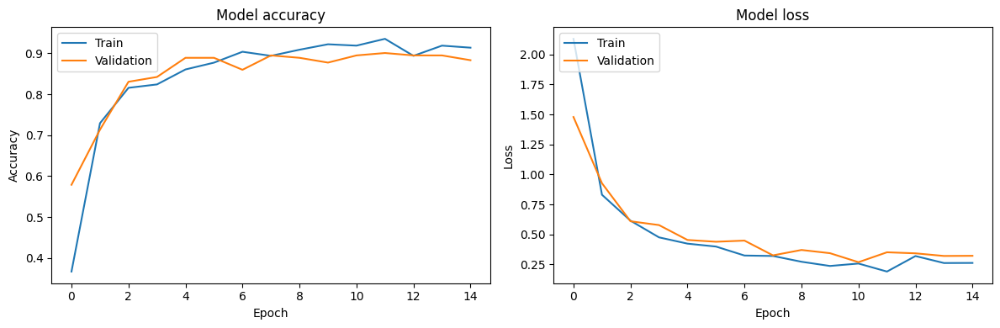

In [137]:
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 385ms/step - accuracy: 0.8755 - loss: 0.9338
Test Accuracy: 89.13%
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 399ms/step


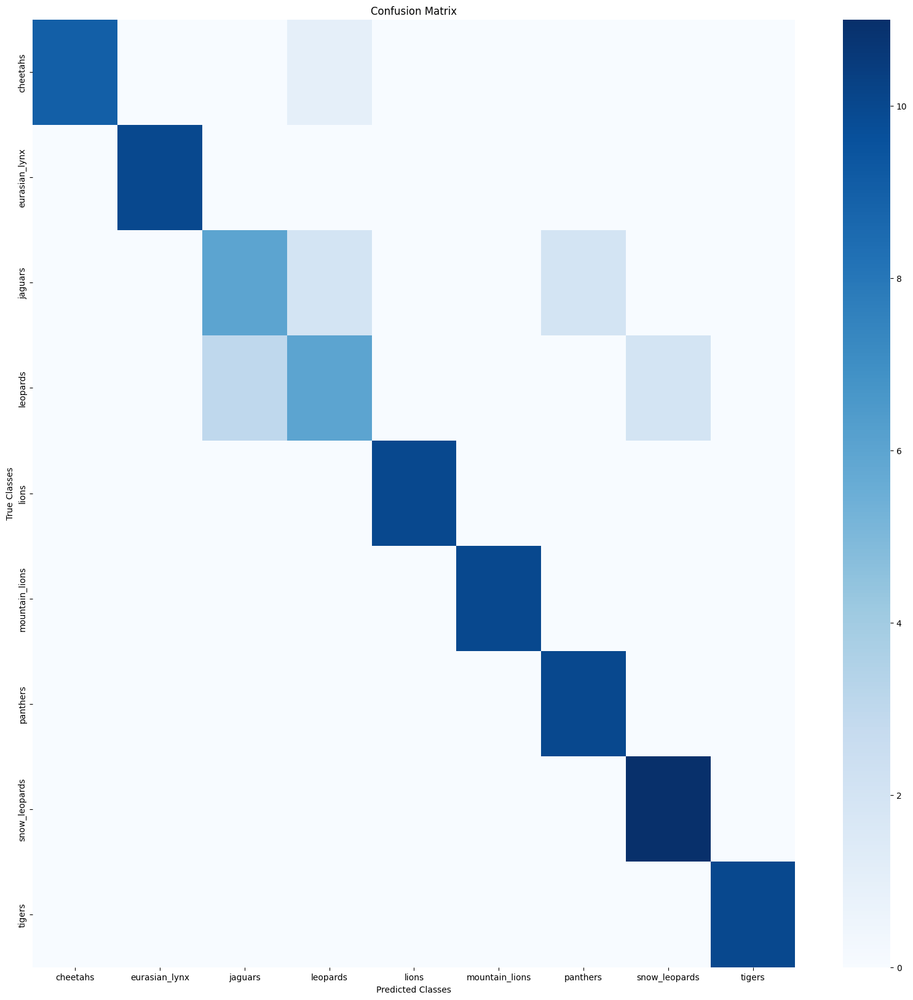

                precision    recall  f1-score   support

      cheetahs       1.00      0.90      0.95        10
 eurasian_lynx       1.00      1.00      1.00        10
       jaguars       0.67      0.60      0.63        10
      leopards       0.67      0.55      0.60        11
         lions       1.00      1.00      1.00        10
mountain_lions       1.00      1.00      1.00        10
      panthers       0.83      1.00      0.91        10
 snow_leopards       0.85      1.00      0.92        11
        tigers       1.00      1.00      1.00        10

      accuracy                           0.89        92
     macro avg       0.89      0.89      0.89        92
  weighted avg       0.89      0.89      0.89        92



In [138]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Predictions and confusion matrix
y_true = test_generator.classes
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

# Confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
class_names = list(test_generator.class_indices.keys())

# Plot the confusion matrix
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Classes')
plt.ylabel('True Classes')
plt.show()

# Classification report
print(classification_report(y_true, y_pred_classes, target_names=class_names))

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


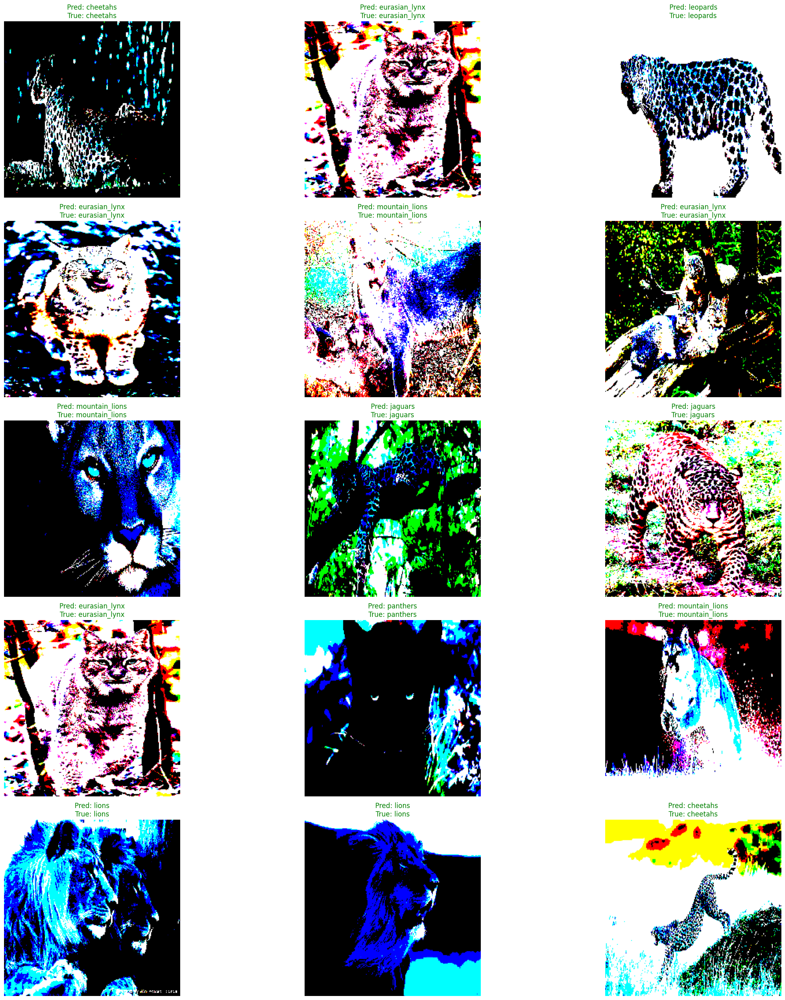

In [139]:
import matplotlib.pyplot as plt
import numpy as np

# Set rows, cols for the grid
rows, cols = 5, 3
size = 25

# Get a batch of images and labels from the test generator
X_test, y_test = next(test_generator)  # Retrieve one batch of test data
y_true = np.argmax(y_test, axis=1)  # Convert one-hot to class indices

# Predict the labels for the batch
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Class names
class_names = list(test_generator.class_indices.keys())

# Create a figure for visualization
fig, ax = plt.subplots(rows, cols)
fig.set_size_inches(size, size)

# Plot the images in a grid with predicted and true labels
for i in range(rows):
    for j in range(cols):
        index = np.random.randint(0, len(X_test))  # Randomly select an image from the batch
        img = X_test[index]
        true_label = class_names[y_true[index]]
        pred_label = class_names[y_pred_classes[index]]

        # Display the image
        ax[i, j].imshow(img)
        ax[i, j].axis('off')  # Remove axes for better visualization

        # Set the title with predicted and true labels
        color = 'green' if true_label == pred_label else 'red'
        ax[i, j].set_title(f"Pred: {pred_label}\nTrue: {true_label}", color=color)

plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


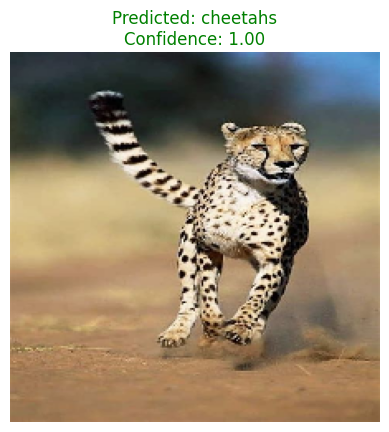

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


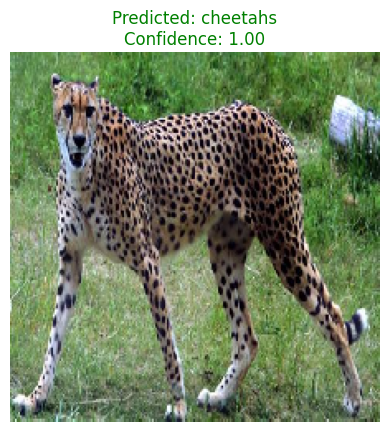

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


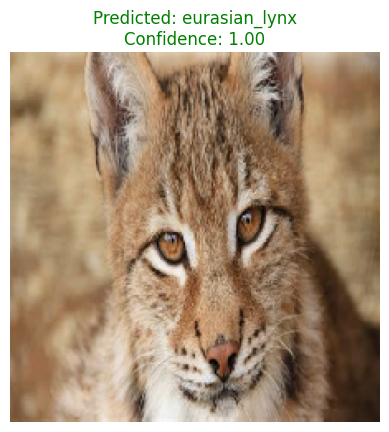

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


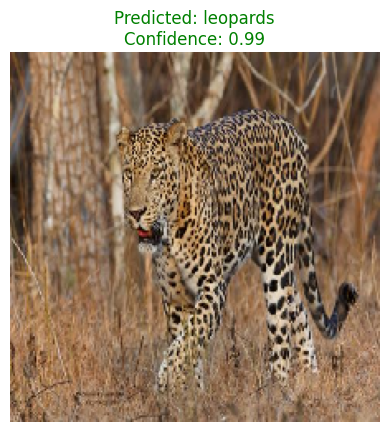

In [140]:
# Example usage
class_names = list(test_generator.class_indices.keys())  # Get class names from the test generator
test_image_path = '/kaggle/input/big-cats-images-dataset/cheetahs/image10.jpg'  # Replace with the path to your test image
test_single_image(test_image_path, model, class_names)

test_single_image('/kaggle/input/big-cats-images-dataset/cheetahs/image3.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/eurasian_lynx/image12.jpg', model, class_names)
test_single_image('/kaggle/input/big-cats-images-dataset/leopards/image14.jpg', model, class_names)

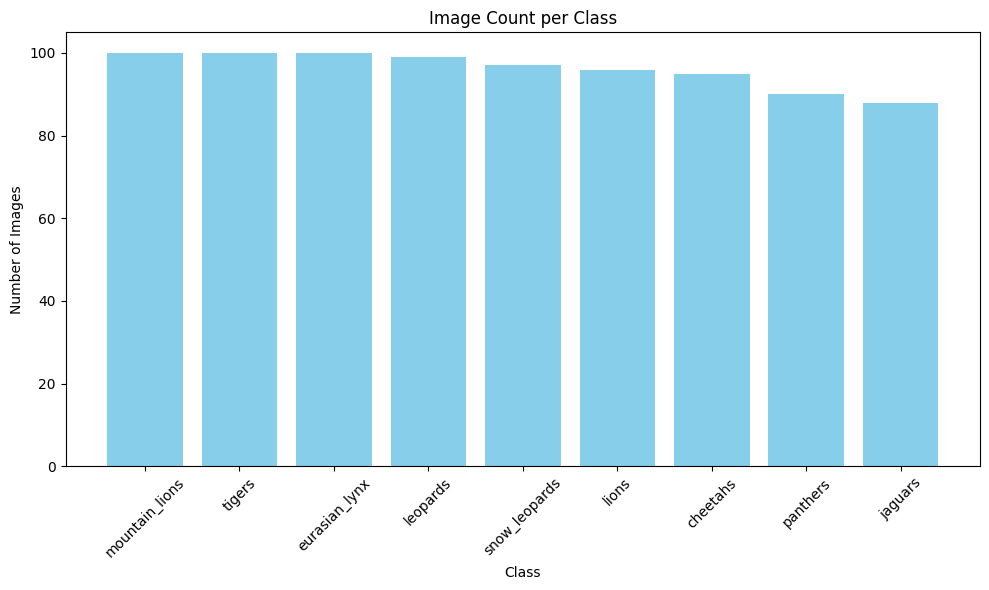

In [141]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Path to your dataset directory (each class is a folder)
dataset_dir = path

# Get class names and image counts
data = []
for class_name in os.listdir(dataset_dir):
    class_path = os.path.join(dataset_dir, class_name)
    if os.path.isdir(class_path):
        image_count = len([f for f in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, f))])
        data.append({'Class': class_name, 'Image Count': image_count})

# Create DataFrame
df = pd.DataFrame(data)

# Sort by image count (optional)
df = df.sort_values('Image Count', ascending=False)

# Plot
plt.figure(figsize=(10, 6))
plt.bar(df['Class'], df['Image Count'], color='skyblue')
plt.xlabel('Class')
plt.ylabel('Number of Images')
plt.title('Image Count per Class')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [142]:
# Add percentage column
df['Percentage'] = (df['Image Count'] / df['Image Count'].sum()) * 100

# Display the table
print(df)

# Optional: Round percentages
df['Percentage'] = df['Percentage'].round(2)

            Class  Image Count  Percentage
4  mountain_lions          100   11.560694
6          tigers          100   11.560694
5   eurasian_lynx          100   11.560694
3        leopards           99   11.445087
7   snow_leopards           97   11.213873
0           lions           96   11.098266
2        cheetahs           95   10.982659
1        panthers           90   10.404624
8         jaguars           88   10.173410


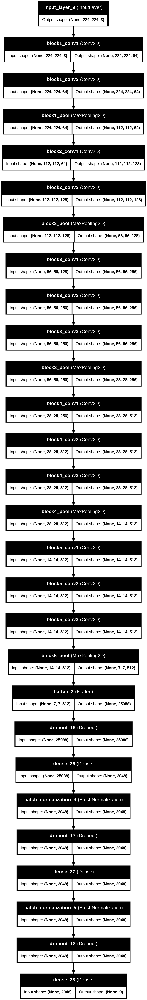

In [143]:
from tensorflow.keras.utils import plot_model

plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True)
